# CUDA Parallel Programming Final Project  
Group 15 - Members:  
- Ngô Văn Anh Kiệt - 19127191  
- Bùi Đăng Khoa - 19127645  

## 1. Application description - Seam Carving  
Seam carving is an image resizing algorithm that is aware of the image context. This means it can change the size of image without distorting or changing the relative scaling of the objects within that image too much.  

The algorithm is widely used for image retargeting, which is the task of displaying images without distortion on media of various sizes (cell phones, projection screens, etc.) using document standards, like HTML, that already support dynamic changes in page layout and text but not images.[

The algorithm takes in an RGB image of size M x N then outputs a new image with size M' x N'. With this kind of 2D input, there's a lot of parallelization potentials in seam carving, since the number of pixels in an image can be very large. We will see in the sequential implementation how slow the algorithm is without parallel programming.

## 2. Sequential implementation  
Just as the name suggest, the idea of the algorithm is to find a certain number of non-important seams, which are lines of connected pixels, to delete or duplicate them in the image. 

Steps to do seam carving implementation **sequentially**:  
- First, turn the RGB image to grayscale image for easier processing in the following steps;  

- Second, apply a set of image filters on the image *independently* in order to detect edges of context objects. This can be done with the convolution operation;  

- Third, from the set of filtered results, add the absolute value of them altogether (pixel-by-pixel) to calculate the importance measurement of each pixel;  

- Fourth, use the scanning technique with dynamic programming to construct a matrix that records the least importance pixels;  

- Fifth, with the matrix from previous step, traceback from the bottom row up to find the least important seam. Do this K times to find K seams. The K value must not be too large or the effect of seam carving will be lost, then it will just be normal image resizing. So the K value should be small enough to find K least importance seams but not too small that it affects the running time;  

- Sixth, sort the list of seams in ascending order of their pixels' positions in the image (top-left to bottom-right). This is so that we can perform seam removal/duplication with O(width) time complexity for each row in the next step;  

- Finally, from the sorted seams positions, apply the seams to remove or duplicate the input pixels at the positions of those seams.  

If the size difference needed between input and output image is a lot, simply repeat from step 1 to 7 to find K least important seams in each loop, until the output size meets the requirements.  

For now, we only do the resizing of width, if we have more time we would implement the resizing of height by transposing the image then repeat the above process.

The image filters used are: top-sobel, left-sobel, right-sobel, and outline filter. This is so that we can accurately detect the edges of context objects in the image, thus gain better seam carving results.

Our implementation takes in the path to input/output images, the desired width, a flag to print verbose run information, the maximum number of K seam in each loop (ratio over the width of the image).  

Here are the run results of the sequential implementation. We use 3 images of sizes: small (width = 256), medium (width = 480), large (2K). Unfortunately, we didn't have enough time to setup a library for Image I/O for C on Windows so we use the binary PPM/PNM image format.  

We notice the larger the image, the higher ratio should be used. For small images, a ratio of 0.01-0.05 should be good. For medium images, the ratio can be between 0.05-0.1. For large images, we should use a ratio higher than 0.1, but not exceeding 0.5 or we will lose the effect of seam carving.

In [ ]:
# Build the program
!nvcc -arch=sm_75 /content/sequential_main.cu -o seam_sequential.out

First, try reducing the width of images.

In [ ]:
# Run program on each image
!./seam_sequential.out 256_p6.pnm small_seq.pnm 180 0 0.03

Run with block size: 32 x 32 - Max seam ratio: 0.03
Image size (width x height): 256 x 256
Desired image width: 180
Total seams needed: 76 - Max usable seams: 7

Saved output image to 'small_seq.pnm'

Total processing time: 269.783630 ms

Average time in each phase:
-> Convert RGB to Grayscale: 0.468437 ms
-> Apply filters: 19.041368 ms
-> Calculate pixel importance: 0.982384 ms
-> Construct least pixel-importance matrix: 1.608037 ms
-> Find K least important seams: 0.059301 ms
-> Sort K seams' positions: 0.075208 ms
-> Reduce/Enlarge image: 0.247232 ms



In [ ]:
!./seam_sequential.out Cat03.pnm med_seq.pnm 360 0 0.05

Run with block size: 32 x 32 - Max seam ratio: 0.05
Image size (width x height): 481 x 480
Desired image width: 360
Total seams needed: 121 - Max usable seams: 24

Saved output image to 'med_seq.pnm'

Total processing time: 551.723511 ms

Average time in each phase:
-> Convert RGB to Grayscale: 1.583301 ms
-> Apply filters: 65.981392 ms
-> Calculate pixel importance: 3.297806 ms
-> Construct least pixel-importance matrix: 5.848091 ms
-> Find K least important seams: 0.791662 ms
-> Sort K seams' positions: 0.419054 ms
-> Reduce/Enlarge image: 0.896329 ms



In [ ]:
!./seam_sequential.out hd_p6.pnm large_seq.pnm 1980 0 0.2

Run with block size: 32 x 32 - Max seam ratio: 0.20
Image size (width x height): 2587 x 1709
Desired image width: 1980
Total seams needed: 607 - Max usable seams: 517

Saved output image to 'large_seq.pnm'

Total processing time: 32967.707031 ms

Average time in each phase:
-> Convert RGB to Grayscale: 35.167900 ms
-> Apply filters: 1385.524658 ms
-> Calculate pixel importance: 69.805153 ms
-> Construct least pixel-importance matrix: 122.951584 ms
-> Find K least important seams: 12.764084 ms
-> Sort K seams' positions: 2.996914 ms
-> Reduce/Enlarge image: 19.174976 ms



In [ ]:
from PIL import Image

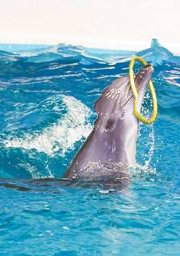

In [ ]:
img = Image.open("small_seq.pnm")
display(img)

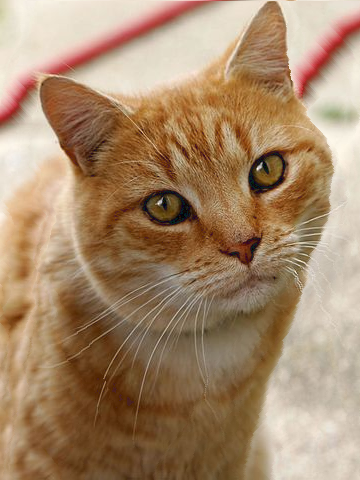

In [ ]:
img = Image.open("med_seq.pnm")
display(img)

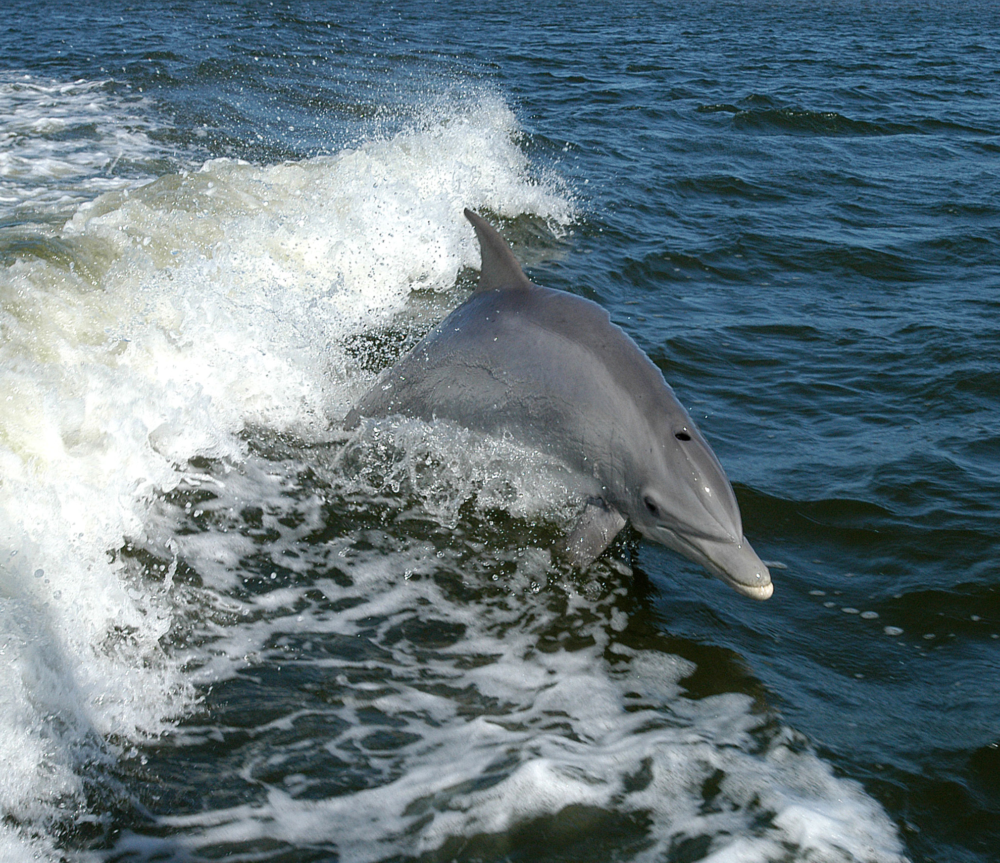

In [ ]:
img = Image.open("large_seq.pnm")
display(img)

Next, increase image size.

In [ ]:
!./seam_sequential.out 256_p6.pnm small_incr_seq.pnm 320 0 0.5

Run with block size: 32 x 32 - Max seam ratio: 0.50
Image size (width x height): 256 x 256
Desired image width: 320
Total seams needed: 64 - Max usable seams: 128

Saved output image to 'small_incr_seq.pnm'

Total processing time: 93.308403 ms

Average time in each phase:
-> Convert RGB to Grayscale: 0.538856 ms
-> Apply filters: 19.364759 ms
-> Calculate pixel importance: 0.966208 ms
-> Construct least pixel-importance matrix: 1.630768 ms
-> Find K least important seams: 0.222920 ms
-> Sort K seams' positions: 0.214296 ms
-> Reduce/Enlarge image: 0.389296 ms



In [ ]:
!./seam_sequential.out Cat03.pnm med_incr_seq.pnm 600 0 0.05

Run with block size: 32 x 32 - Max seam ratio: 0.05
Image size (width x height): 481 x 480
Desired image width: 600
Total seams needed: 119 - Max usable seams: 24

Saved output image to 'med_incr_seq.pnm'

Total processing time: 681.602112 ms

Average time in each phase:
-> Convert RGB to Grayscale: 2.061262 ms
-> Apply filters: 81.049889 ms
-> Calculate pixel importance: 4.027291 ms
-> Construct least pixel-importance matrix: 7.223109 ms
-> Find K least important seams: 1.115159 ms
-> Sort K seams' positions: 0.440256 ms
-> Reduce/Enlarge image: 1.454766 ms



In [ ]:
!./seam_sequential.out hd_p6.pnm large_incr_seq.pnm 3300 0 0.3

Run with block size: 32 x 32 - Max seam ratio: 0.30
Image size (width x height): 2587 x 1709
Desired image width: 3300
Total seams needed: 713 - Max usable seams: 776

Saved output image to 'large_incr_seq.pnm'

Total processing time: 70060.710938 ms

Average time in each phase:
-> Convert RGB to Grayscale: 45.072529 ms
-> Apply filters: 1736.303223 ms
-> Calculate pixel importance: 86.725365 ms
-> Construct least pixel-importance matrix: 149.972778 ms
-> Find K least important seams: 15.695770 ms
-> Sort K seams' positions: 1.829207 ms
-> Reduce/Enlarge image: 25.010462 ms



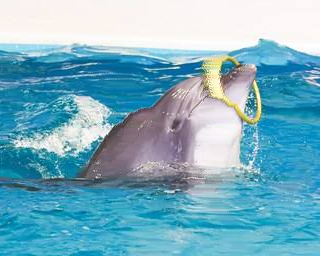

In [ ]:
img = Image.open("small_incr_seq.pnm")
display(img)

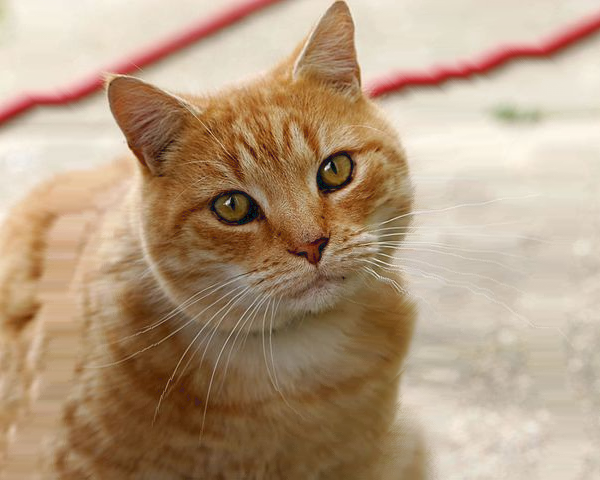

In [ ]:
img = Image.open("med_incr_seq.pnm")
display(img)

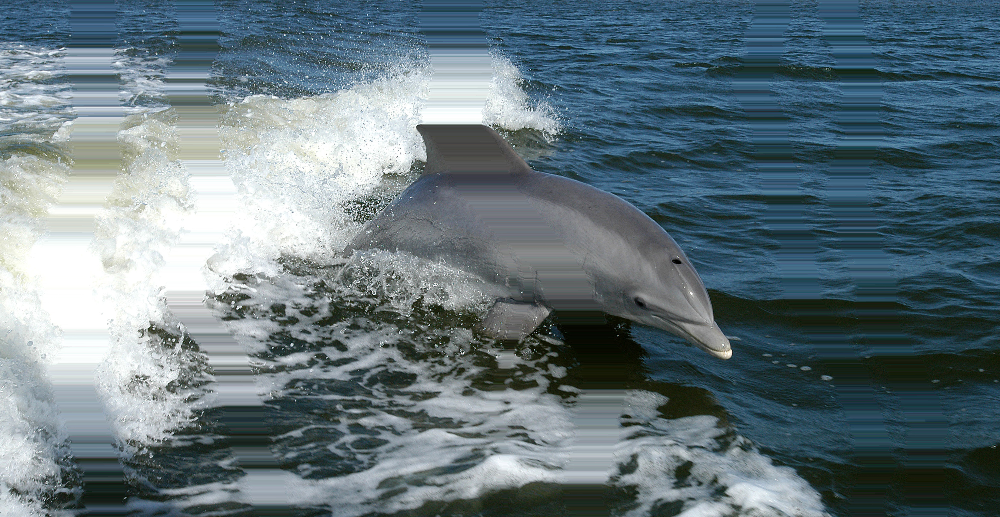

In [ ]:
img = Image.open("large_incr_seq.pnm")
display(img)

We notice some interesting things from the result images. With the small and large image, they don't look too good, and the distortion is very noticeable. This can be due to setting the maximum seam ratio incorrectly. However, after investigating the result in each phase, we see that for the small and large image, the filtered images after step 2 have lots of noises and the shapes of the dolphins are hard to notice due to the bubbling water around it. This can be because the water surface in these images has lots of bright-colored waves and bubbles while the color of the dolphins kind of blend in with the water color. We tried to use 4 filters instead of the original 2 filters to get better edge detection but this is the best results we can get. On the other hand, the cat image looks very good because the background of the original image has been blurred so the shape of the cat can be detected better.

As we can see, except for the traceback to find K least important seams in step 5 and the sorting of those seams in step 6, all other steps see huge increase in run time as the image gets larger. The second step where we apply the filters is the slowest with steepest increase in run time. We will try to optimize these step with parallelization. Step 5 will be parallelize partially while step 6 doesn't need to be parallelized.

## 3. Parallel Implementation  
We will try to parallelize step 1-5, 7. With step 5 being partially parallelized. Step 6 can be kept sequential.  
The idea for each step is as follow:  
- Step 1: We simply assign each GPU thread the task to convert the a pixel with respect to the thread & block ID into grayscale value.  

- Step 2: This is one of the heaviest part of the parallelization. We try to apply the image filter independently on the grayscale input. Meaning that for each filter, we assign the convolution task to a separate CUDA stream, then each stream performs convolution using their respective filter. The results will be collected in a 2D array where the first dimension is according to the number of filters, the second dimension is the flatten output of each filter. We also try to using constant device memory for the filters and shared memory during convolution.  

- Step 3: To calculate importance of each pixel, first we flatten the input 2D array which is the output of last step. Then we assign each GPU thread to sum the result of all 4 filters together.  

- Step 4: To build the importance matrix, we use the parallel implementation of the scanning technique. At each height (from bottom-up), we assign GPU threads to scan the 3 pixels below it for the minimum.  

- Step 5: This step isn't too slow so we don't have to do any complex parallelization. Just need to parallel the mapping of the pair: pixel importance and position in each row. Then the traceback is done sequentially to return the pixel position of each pixel in each seam.  

- Step 6: No need for parallelization. Quicksort is quite fast and the output of last step isn't too big. The size of the input is just K seam * height so Quicksort can handle it easily.  

- Step 7: In each height, we remove/duplicate the row independently so we simply assign a GPU thread for each row. The removal/duplication is done using 2 pointers for input and output so the time complexity is O(width) in each row instead of O(width * width).

In [ ]:
# Check NVIDIA driver version and CUDA version
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0


In [ ]:
!nvidia-smi

Tue Jan 10 22:20:30 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   60C    P0    28W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [15]:
# Build the programs
!nvcc -arch=sm_75 /content/parallel_main_v1.cu -o seam_parallel_v1.out
!nvcc -arch=sm_75 /content/parallel_main_v2.cu -o seam_parallel_v2.out

### Version 1  
In this version, we don't use shared memory and constant memory for step 2. Step 5 and 6 will be fully sequential.  
We use the same experiment setup as sequential implementation. First is reducing image size.

In [ ]:
!./seam_parallel_v1.out 256_p6.pnm small_para_v1.pnm 180 0 0.03

Run with block size: 32 x 32 - Max seam ratio: 0.03
Image size (width x height): 256 x 256
Desired image width: 180
Total seams needed: 76 - Max usable seams: 7

Saved output image to 'small_para_v1.pnm'

Total processing time: 66.223846 ms

Average time in each phase:
-> Convert RGB to Grayscale: 0.311595 ms
-> Apply filters: 1.175819 ms
-> Calculate pixel importance: 0.617269 ms
-> Construct least pixel-importance matrix: 2.771200 ms
-> Find K least important seams: 0.102571 ms
-> Sort K seams' positions: 0.073509 ms
-> Reduce/Enlarge image: 0.466691 ms



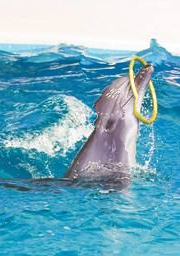

In [ ]:
img = Image.open("small_para_v1.pnm")
display(img)

In [ ]:
!./seam_parallel_v1.out Cat03.pnm med_para_v1.pnm 360 0 0.05

Run with block size: 32 x 32 - Max seam ratio: 0.05
Image size (width x height): 481 x 480
Desired image width: 360
Total seams needed: 121 - Max usable seams: 24

Saved output image to 'med_para_v1.pnm'

Total processing time: 83.958321 ms

Average time in each phase:
-> Convert RGB to Grayscale: 0.616334 ms
-> Apply filters: 1.944549 ms
-> Calculate pixel importance: 1.865106 ms
-> Construct least pixel-importance matrix: 5.161033 ms
-> Find K least important seams: 1.109906 ms
-> Sort K seams' positions: 0.402277 ms
-> Reduce/Enlarge image: 0.894843 ms

Inconsistency detected by ld.so: dl-fini.c: 87: _dl_fini: Assertion `ns != LM_ID_BASE || i == nloaded' failed!


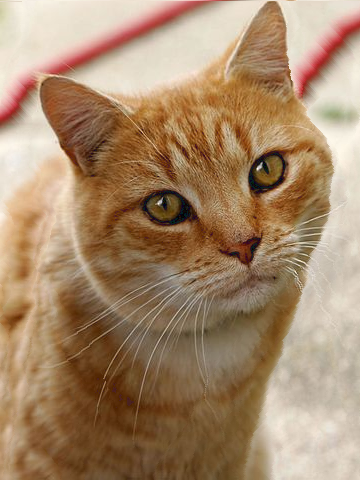

In [ ]:
img = Image.open("med_para_v1.pnm")
display(img)

In [ ]:
!./seam_parallel_v1.out hd_p6.pnm large_para_v1.pnm 1980 0 0.2

Run with block size: 32 x 32 - Max seam ratio: 0.20
Image size (width x height): 2587 x 1709
Desired image width: 1980
Total seams needed: 607 - Max usable seams: 517

Saved output image to 'large_para_v1.pnm'

Total processing time: 2383.527588 ms

Average time in each phase:
-> Convert RGB to Grayscale: 8.360145 ms
-> Apply filters: 18.958607 ms
-> Calculate pixel importance: 26.233072 ms
-> Construct least pixel-importance matrix: 32.494762 ms
-> Find K least important seams: 13.658575 ms
-> Sort K seams' positions: 2.798542 ms
-> Reduce/Enlarge image: 10.997583 ms



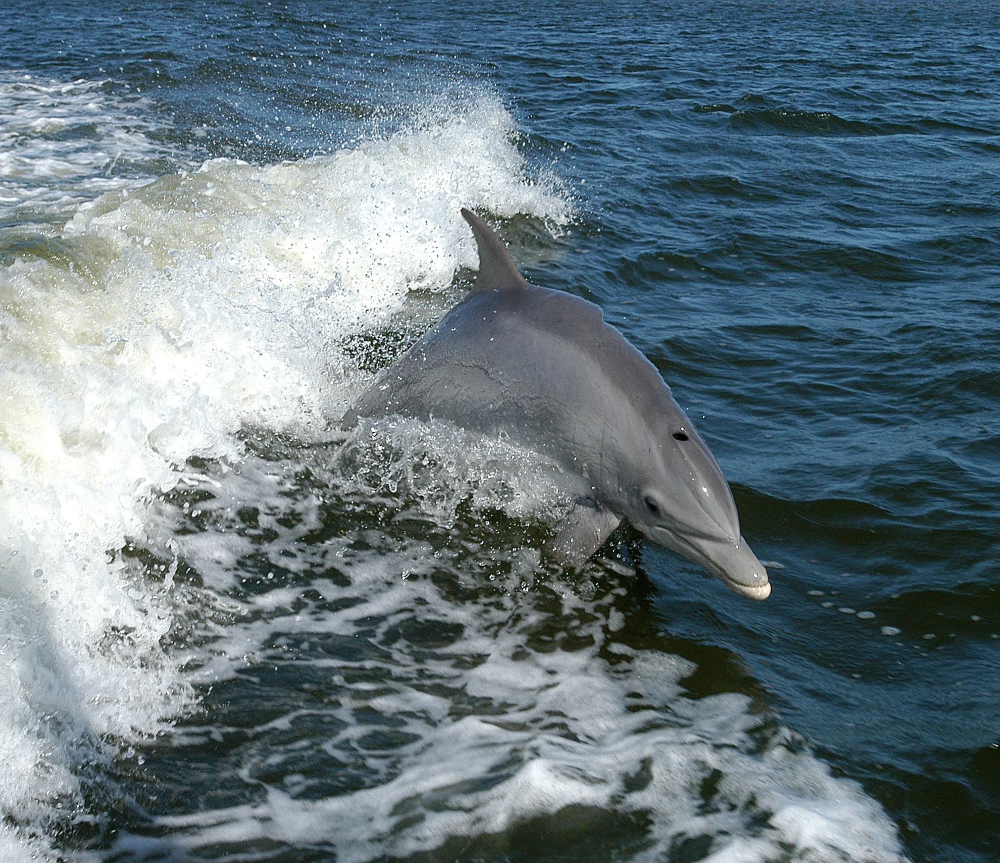

In [ ]:
img = Image.open("large_para_v1.pnm")
display(img)

Then increasing the image size

In [ ]:
!./seam_parallel_v1.out 256_p6.pnm small_incr_para_v1.pnm 320 0 0.5

Run with block size: 32 x 32 - Max seam ratio: 0.50
Image size (width x height): 256 x 256
Desired image width: 320
Total seams needed: 64 - Max usable seams: 128

Saved output image to 'small_incr_para_v1.pnm'

Total processing time: 24.217920 ms

Average time in each phase:
-> Convert RGB to Grayscale: 0.338432 ms
-> Apply filters: 1.127496 ms
-> Calculate pixel importance: 0.691752 ms
-> Construct least pixel-importance matrix: 2.648832 ms
-> Find K least important seams: 0.343248 ms
-> Sort K seams' positions: 0.254424 ms
-> Reduce/Enlarge image: 0.650296 ms



In [ ]:
!./seam_parallel_v1.out Cat03.pnm med_incr_para_v1.pnm 600 0 0.05

Run with block size: 32 x 32 - Max seam ratio: 0.05
Image size (width x height): 481 x 480
Desired image width: 600
Total seams needed: 119 - Max usable seams: 24

Saved output image to 'med_incr_para_v1.pnm'

Total processing time: 100.320770 ms

Average time in each phase:
-> Convert RGB to Grayscale: 0.807685 ms
-> Apply filters: 2.529298 ms
-> Calculate pixel importance: 2.254775 ms
-> Construct least pixel-importance matrix: 5.708302 ms
-> Find K least important seams: 1.389413 ms
-> Sort K seams' positions: 0.441879 ms
-> Reduce/Enlarge image: 1.200187 ms



In [ ]:
!./seam_parallel_v1.out hd_p6.pnm large_incr_para_v1.pnm 3300 0 0.2

Run with block size: 32 x 32 - Max seam ratio: 0.20
Image size (width x height): 2587 x 1709
Desired image width: 3300
Total seams needed: 713 - Max usable seams: 517

Saved output image to 'large_incr_para_v1.pnm'

Total processing time: 4421.474121 ms

Average time in each phase:
-> Convert RGB to Grayscale: 10.525662 ms
-> Apply filters: 22.185984 ms
-> Calculate pixel importance: 34.023998 ms
-> Construct least pixel-importance matrix: 36.152283 ms
-> Find K least important seams: 15.418505 ms
-> Sort K seams' positions: 2.015388 ms
-> Reduce/Enlarge image: 13.662250 ms



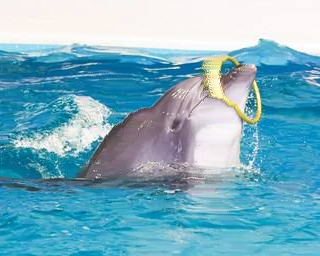

In [ ]:
img = Image.open("small_incr_para_v1.pnm")
display(img)

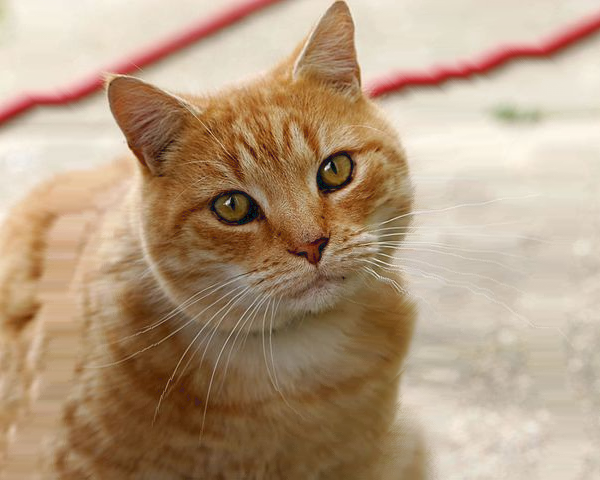

In [ ]:
img = Image.open("med_incr_para_v1.pnm")
display(img)

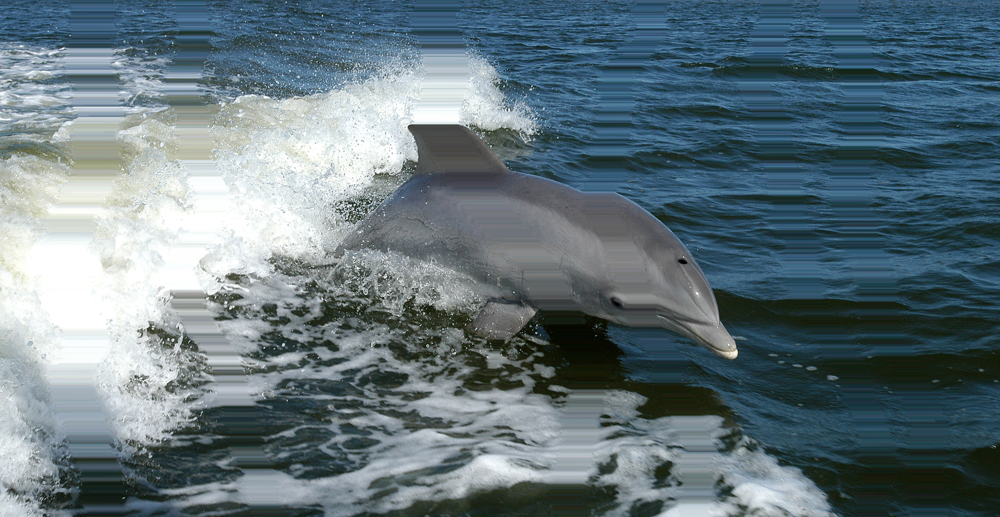

In [ ]:
img = Image.open("large_incr_para_v1.pnm")
display(img)

## Version 2  
In this version, we do convolution in step 2 with shared memory and constant memory in device. Step 5 will also be partially parallel.

Reduce image size

In [ ]:
!./seam_parallel_v2.out 256_p6.pnm small_para_v2.pnm 180 0 0.03

Run with block size: 16 x 16 - Max seam ratio: 0.03
Image size (width x height): 256 x 256
Desired image width: 180
Total seams needed: 76 - Max usable seams: 7

Saved output image to 'small_para_v2.pnm'

Total processing time: 67.563202 ms

Average time in each phase:
-> Convert RGB to Grayscale: 0.322997 ms
-> Apply filters: 1.158128 ms
-> Calculate pixel importance: 0.630776 ms
-> Construct least pixel-importance matrix: 2.770602 ms
-> Find K least important seams: 0.272984 ms
-> Sort K seams' positions: 0.067456 ms
-> Reduce/Enlarge image: 0.407323 ms



In [24]:
!./seam_parallel_v1.out Cat03.pnm med_para_v2.pnm 380 0 0.05

Run with block size: 32 x 32 - Max seam ratio: 0.05
Image size (width x height): 481 x 480
Desired image width: 380
Total seams needed: 101 - Max usable seams: 24

Saved output image to 'med_para_v2.pnm'

Total processing time: 73.184723 ms

Average time in each phase:
-> Convert RGB to Grayscale: 0.649968 ms
-> Apply filters: 2.014160 ms
-> Calculate pixel importance: 1.895350 ms
-> Construct least pixel-importance matrix: 5.315397 ms
-> Find K least important seams: 1.036533 ms
-> Sort K seams' positions: 0.372619 ms
-> Reduce/Enlarge image: 0.913429 ms

Inconsistency detected by ld.so: dl-fini.c: 87: _dl_fini: Assertion `ns != LM_ID_BASE || i == nloaded' failed!


In [23]:
!./seam_parallel_v2.out hd_p6.pnm large_para_v2.pnm 1980 0 0.2

Run with block size: 32 x 32 - Max seam ratio: 0.20
Image size (width x height): 2587 x 1709
Desired image width: 1980
Total seams needed: 607 - Max usable seams: 517

Saved output image to 'large_para_v2.pnm'

Total processing time: 2379.028320 ms

Average time in each phase:
-> Convert RGB to Grayscale: 8.270072 ms
-> Apply filters: 18.335999 ms
-> Calculate pixel importance: 26.110117 ms
-> Construct least pixel-importance matrix: 33.165451 ms
-> Find K least important seams: 13.728416 ms
-> Sort K seams' positions: 2.677775 ms
-> Reduce/Enlarge image: 10.999239 ms



Increase image size

In [18]:
!./seam_parallel_v2.out 256_p6.pnm small_incr_para_v2.pnm 320 0 0.5

Run with block size: 32 x 32 - Max seam ratio: 0.50
Image size (width x height): 256 x 256
Desired image width: 320
Total seams needed: 64 - Max usable seams: 128

Saved output image to 'small_incr_para_v2.pnm'

Total processing time: 22.082144 ms

Average time in each phase:
-> Convert RGB to Grayscale: 0.324864 ms
-> Apply filters: 0.993736 ms
-> Calculate pixel importance: 0.626832 ms
-> Construct least pixel-importance matrix: 2.378896 ms
-> Find K least important seams: 0.466816 ms
-> Sort K seams' positions: 0.193568 ms
-> Reduce/Enlarge image: 0.535824 ms



In [19]:
!./seam_parallel_v2.out Cat03.pnm med_incr_para_v2.pnm 600 0 0.05

Run with block size: 32 x 32 - Max seam ratio: 0.05
Image size (width x height): 481 x 480
Desired image width: 600
Total seams needed: 119 - Max usable seams: 24

Saved output image to 'med_incr_para_v2.pnm'

Total processing time: 101.285355 ms

Average time in each phase:
-> Convert RGB to Grayscale: 0.790907 ms
-> Apply filters: 2.427890 ms
-> Calculate pixel importance: 2.315927 ms
-> Construct least pixel-importance matrix: 5.767396 ms
-> Find K least important seams: 1.593010 ms
-> Sort K seams' positions: 0.387872 ms
-> Reduce/Enlarge image: 1.186332 ms



In [20]:
!./seam_parallel_v2.out hd_p6.pnm large_incr_para_v2.pnm 3300 0 0.2

Run with block size: 32 x 32 - Max seam ratio: 0.20
Image size (width x height): 2587 x 1709
Desired image width: 3300
Total seams needed: 713 - Max usable seams: 517

Saved output image to 'large_incr_para_v2.pnm'

Total processing time: 4340.291504 ms

Average time in each phase:
-> Convert RGB to Grayscale: 10.586476 ms
-> Apply filters: 22.429285 ms
-> Calculate pixel importance: 33.084457 ms
-> Construct least pixel-importance matrix: 36.947323 ms
-> Find K least important seams: 16.880350 ms
-> Sort K seams' positions: 2.047937 ms
-> Reduce/Enlarge image: 13.658289 ms



## References  
- Seam Carving for Content-Aware Image Resizing - https://perso.crans.org/frenoy/matlab2012/seamcarving.pdf  